<a href="https://colab.research.google.com/github/morimoto0929/conflict_practice/blob/main/xrain_keras_transformer_multistep_conv.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## 必要なものをインストール

In [ ]:
!pip install tensorboardX blosc2
!sudo apt install ffmpeg
!pip uninstall -y keras-hub
!pip install -U -q keras-nlp

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 87.2/87.2 kB 2.7 MB/s eta 0:00:00
Reading package lists... Done
Building dependency tree... Done
Reading state information... Done
ffmpeg is already the newest version (7:4.4.2-0ubuntu0.22.04.1).
0 upgraded, 0 newly installed, 0 to remove and 35 not upgraded.
Found existing installation: keras-hub 0.21.1
Uninstalling keras-hub-0.21.1:
  Successfully uninstalled keras-hub-0.21.1
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 947.9/947.9 kB 15.5 MB/s eta 0:00:00


## mount

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


## 各ライブラリのインポート

In [ ]:
import os
import datetime
import math
os.environ["KERAS_BACKEND"] = "torch"
import keras
import numpy as np
import tensorboardX
import huggingface_hub
import blosc2
import tensorflow as tf
import keras_nlp
from keras.saving import register_keras_serializable
print(keras_nlp.__version__)

0.22.0


## データセットの読み込み
huggingface hubからデータセットをダウンロード

In [ ]:
from huggingface_hub import hf_hub_download
import numpy as np

# 読み込みたい日付
dates = ["2024/08/09", "2024/08/15", "2024/08/20"]

def load_b2nd(date_str: str) -> blosc2.NDArray:
    """Hugging Face から XRAIN の b2nd をダウンロードして開く"""
    yyyy, mm, dd = date_str.split("/")
    path = huggingface_hub.hf_hub_download(
        repo_id="Pj-metdata-prediction/xrain-composite-cx",
        filename=f"b2nd/{yyyy}/{mm}/cx-{yyyy}{mm}{dd}.b2nd",
        repo_type="dataset",
    )
    arr = blosc2.open(path, dparams=blosc2.DParams())
    # ここで arr は blosc2.NDArray（形は (T, 3200, 3200) のはず）
    return arr

# dates = ["2024/08/09", "2024/08/15", "2024/08/20"]
dates = ["2024/08/09", "2024/08/06"]

rain_blocks = [load_b2nd(d) for d in dates]

train_dataset_path = huggingface_hub.hf_hub_download(
    repo_id="Pj-metdata-prediction/xrain-composite-cx",
    filename="b2nd/2024/08/cx-20240809.b2nd",
    repo_type="dataset",
)

train_rains = blosc2.open(train_dataset_path, dparams=blosc2.DParams())
assert isinstance(train_rains, blosc2.NDArray) # 後での推論用

b2nd/2024/08/cx-20240809.b2nd:   0%|          | 0.00/470M [00:00<?, ?B/s]

b2nd/2024/08/cx-20240806.b2nd:   0%|          | 0.00/433M [00:00<?, ?B/s]

In [ ]:

val_dataset_path = huggingface_hub.hf_hub_download(
    repo_id="Pj-metdata-prediction/xrain-composite-cx",
    filename="b2nd/2024/08/cx-20240819.b2nd",
    repo_type="dataset",
)
val_rains = blosc2.open(val_dataset_path, dparams=blosc2.DParams())
assert isinstance(val_rains, blosc2.NDArray)

b2nd/2024/08/cx-20240819.b2nd:   0%|          | 0.00/1.62G [00:00<?, ?B/s]

In [ ]:
lon = np.load('/content/drive/MyDrive/climate_data_platform/xrain/data/metadata/lon_centers.npy')
print(lon.shape)
lat = np.load('/content/drive/MyDrive/climate_data_platform/xrain/data/metadata/lat_centers.npy')
print(lat.shape)

(3200, 3200)
(3200, 3200)


## dataset の処理

In [ ]:
lon_min, lon_max = 138, 140
lat_min, lat_max = 35,  37

lat_axis = lat[:, 0]         # shape (3200,)
lon_axis = lon[0, :]         # shape (3200,)

idx_lat = np.where((lat_axis >= lat_min) & (lat_axis <= lat_max))[0]
idx_lon = np.where((lon_axis >= lon_min) & (lon_axis <= lon_max))[0]

LAT_SLICE = slice(idx_lat.min(), idx_lat.max() + 1)   # 行 = 緯度
LON_SLICE = slice(idx_lon.min(), idx_lon.max() + 1)

In [ ]:
SEQ_LEN      = 5
DOWNSAMPLE   = 10
SCALE_FACTOR = 300.0      # mm h‑1 の上限
BATCH_SIZE   = 1         # ConvLSTM はメモリ使用量大
EPOCHS       = 200

N_STEPS = 5

# 縮小後の空間サイズを自動算出
H = math.ceil((LAT_SLICE.stop - LAT_SLICE.start) / DOWNSAMPLE)  # 緯度方向
W = math.ceil((LON_SLICE.stop - LON_SLICE.start) / DOWNSAMPLE)  # 経度方向
print(f"Input size  : (T={SEQ_LEN}, H={H}, W={W})")

# ------------------------------------------------------------
# 6. データジェネレータ（(seq_len,H,W,1) → (H,W,1)）
# ------------------------------------------------------------
def seq_batch_generator(rains: np.ndarray,
                            batch_size: int,
                            lon_slice: slice,
                            lat_slice: slice,
                            seq_len: int,
                            n_steps: int):
    """
    出力 y は (B, N_STEPS, H, W, 1)
    入力 x は (B, seq_len, H, W, 1)
    """
    N = rains.shape[0]
    while True:
        for t0 in range(0, N - seq_len - n_steps, batch_size):
            xs, ys = [], []
            for t in range(t0, min(t0 + batch_size, N - seq_len - n_steps)):
                # time, lat(Y)=H, lon(X)=W の順で切り出し（順番を絶対に変えない）
                window = rains[t : t + seq_len + n_steps,
                               lat_slice,  # ← 先に Y
                               lon_slice]  # ← 次に X
                window = window[:, ::DOWNSAMPLE, ::DOWNSAMPLE]   # (T,H,W)

                if np.isnan(window).any():
                    continue

                x = window[:seq_len]                   # (seq_len,H,W)
                y = window[seq_len : seq_len+n_steps]  # (n_steps,H,W)

                xs.append(x[..., None])   # (seq_len,H,W,1)
                ys.append(y[..., None])   # (n_steps,H,W,1)

            if xs:
                xs = np.asarray(xs, dtype=np.float32)  # (B,seq_len,H,W,1)
                ys = np.asarray(ys, dtype=np.float32)  # (B,n_steps,H,W,1)

                # 形状チェック（学習開始前に1度だけ print しておくと安心）
                # print("x.shape", xs.shape, "y.shape", ys.shape)
                yield xs, ys

gens = [
    seq_batch_generator(
        b, BATCH_SIZE, LON_SLICE, LAT_SLICE,
        seq_len=SEQ_LEN, n_steps=N_STEPS
    )
    for b in rain_blocks
]

# 3) 各日のだいたいのバッチ数（= 1エポックあたりの「その日」からのサンプル量の目安）
def approx_steps_per_block(b):
    # N_STEPS を差し引く（連続しない日をまたがない窓にする）
    return max(1, (b.shape[0] - SEQ_LEN - N_STEPS) // BATCH_SIZE)

block_steps = [approx_steps_per_block(b) for b in rain_blocks]

# 4) サンプリング確率（長い日ほど多く引く）
weights = np.asarray(block_steps, dtype=np.float64)
weights = weights / weights.sum()

# 5) ミックス・ジェネレータ（無限ループ）
def mixed_train_gen(gens, weights):
    while True:
        k = np.random.choice(len(gens), p=weights)
        yield next(gens[k])

train_gen = mixed_train_gen(gens, weights)

# 6) steps_per_epoch は「各日の概算バッチ数の合計」を採用
steps_per_epoch = int(np.sum(block_steps))

# 検証は1日ぶんを素直に使うのが堅実（連続性が保てる）
val_gen = seq_batch_generator(
    val_rains, BATCH_SIZE, LON_SLICE, LAT_SLICE,
    seq_len=SEQ_LEN, n_steps=N_STEPS
)
val_steps = max(1, (val_rains.shape[0] - SEQ_LEN - N_STEPS) // BATCH_SIZE)

Input size  : (T=5, H=96, W=64)


## モデルの定義
kerasのFunction APIを使ってTransformerを用いたものを作成

In [ ]:
import math, keras, numpy as np
from keras import layers, models
from keras import mixed_precision as mp
# from keras_nlp.layers import PerformerEncoder

mp.set_global_policy("mixed_float16")

In [ ]:
def make_pos_encoding(T: int, H: int, W: int, D: int):
    """
    3-D positional encoding
      shape = (T, H*W, D)
      D は 4 の倍数
    """
    assert D % 4 == 0
    d_time = D // 2
    d_xy   = D // 4
    L      = H * W                     # パッチ数

    # -------- Time ------------------------------------------------
    div_t  = np.exp(np.arange(0, d_time, 2) * -(math.log(10000.0) / d_time))
    pos_t  = np.arange(T, dtype="float32")[:, None]          # (T,1)
    sin_t  = np.sin(pos_t * div_t)[:, None, :]               # (T,1,d_t/2)
    cos_t  = np.cos(pos_t * div_t)[:, None, :]               # (T,1,d_t/2)

    pe_t   = np.zeros((T, 1, d_time), dtype="float32")       # (T,1,d_t)
    pe_t[..., 0::2] = sin_t
    pe_t[..., 1::2] = cos_t
    pe_t   = np.repeat(pe_t, L, axis=1)                      # (T,L,d_t)

    # -------- Space (Y, X) ---------------------------------------
    div_xy = np.exp(np.arange(0, d_xy, 2) * -(math.log(10000.0) / d_xy))
    yv, xv = np.meshgrid(np.arange(H), np.arange(W), indexing="ij")
    yv, xv = yv.reshape(-1, 1).astype("float32"), xv.reshape(-1, 1).astype("float32")

    sin_y, cos_y = np.sin(yv * div_xy), np.cos(yv * div_xy)
    sin_x, cos_x = np.sin(xv * div_xy), np.cos(xv * div_xy)

    pe_xy = np.concatenate([sin_y, cos_y, sin_x, cos_x], axis=-1)  # (L,d_t)
    pe_xy = np.repeat(pe_xy[None, ...], T, axis=0)                 # (T,L,d_t)

    # -------- Merge ----------------------------------------------
    pe = np.concatenate([pe_t, pe_xy], axis=-1)   # (T,L,D)
    return pe

In [ ]:
# ── モデル ──────────────────────────────────────────────
D_MODEL = 128
N_HEAD = 4
N_LAYER = 4
DROP_RATE = 0.1
PATCH = 2
Hp, Wp = H // PATCH, W // PATCH
L      = Hp * Wp

@register_keras_serializable(package="xrain")
def take_last_frame_channel0(t):
    return t[:, -1, ..., 0]

def last_frame_output_shape(input_shape):
    # input_shape = (B, T, H, W, 1) を想定
    return (input_shape[0], input_shape[2], input_shape[3])

def build_base_model():
    inp   = layers.Input(shape=(SEQ_LEN, H, W, 1))
    x_raw = layers.Rescaling(1./SCALE_FACTOR)(inp)               # (B,T,H,W,1)

    # ---- PatchEmbed -> トランスフォーマ ----
    Hp, Wp = H // PATCH, W // PATCH
    L      = Hp * Wp
    x_p    = layers.Reshape((SEQ_LEN, Hp, PATCH, Wp, PATCH, 1))(x_raw)
    x_p    = layers.Permute((1,3,5,2,4,6))(x_p)
    x_p    = layers.Reshape((SEQ_LEN, L, PATCH*PATCH))(x_p)
    x_tok  = layers.Dense(D_MODEL)(x_p)

    pe = make_pos_encoding(SEQ_LEN, Hp, Wp, D_MODEL)[None, ...]  # (1,T,L,D)
    tok = x_tok + pe                                             # (B,T,L,D)

    # ---- フル時空 Self-Attention ----
    S = SEQ_LEN * L
    tok = layers.Reshape((S, D_MODEL))(tok)
    for _ in range(N_LAYER):
        z = layers.LayerNormalization(epsilon=1e-6)(tok)
        z = layers.MultiHeadAttention(
                num_heads=N_HEAD, key_dim=D_MODEL//N_HEAD, dropout=DROP_RATE
            )(z, z)
        tok = layers.Add()([tok, z])

        y = layers.LayerNormalization(epsilon=1e-6)(tok)
        y = layers.Dense(D_MODEL*4, activation="relu")(y)
        y = layers.Dropout(DROP_RATE)(y)
        y = layers.Dense(D_MODEL)(y)
        tok = layers.Add()([tok, y])

    # ---- 最後の時刻 (= 最後の L トークン) -> 画像に復元 ----
    last = tok[:, -L:, :]                                        # (B,L,D)
    x    = layers.Dense(1, kernel_initializer="zeros")(last)     # (B,L,1)
    x    = layers.Reshape((Hp, Wp, 1))(x)
    x    = layers.UpSampling2D(size=(PATCH, PATCH))(x)           # (B,H,W,1)
    delta= layers.Reshape((H, W))(x)                             # (B,H,W)

    # 直近観測（mm/h）を取り出して残差加算 → 非負
    # last_obs = layers.Lambda(lambda t: t[:, -1, ..., 0])(inp)    # (B,H,W)
    last_obs = layers.Lambda(
      take_last_frame_channel0,
      output_shape=last_frame_output_shape,
      name="last_obs"
      )(inp)

    delta    = layers.Activation("tanh")(delta) * 50.0           # 変化量の上限制御
    out      = layers.ReLU()(layers.Add()([last_obs, delta]))    # (B,H,W)

    # ★ autoregressive で扱いやすいようチャネル次元を付けて返す
    out = layers.Reshape((H, W, 1))(out)                         # (B,H,W,1)

    return keras.Model(inp, out, name="base_1step")

base_model = build_base_model()

In [ ]:
import keras
from keras import layers
from keras.saving import register_keras_serializable

@register_keras_serializable(package="xrain")
def expand_time_axis1(t):  # (B,H,W,1) -> (B,1,H,W,1)
    return keras.ops.expand_dims(t, 1)
def expand_time_axis1_shape(s):  # s=(B,H,W,1)
    return (s[0], 1, s[1], s[2], s[3])

@register_keras_serializable(package="xrain")
def slice_time_1_to_end(x):  # (B,T,H,W,1) -> (B,T-1,H,W,1)
    return x[:, 1:, ...]
def slice_time_1_to_end_shape(s):  # s=(B,T,H,W,1)
    return (s[0], s[1]-1, s[2], s[3], s[4])

@register_keras_serializable(package="xrain")
def take_last_time(x):  # (B,N,H,W,1) -> (B,H,W,1)
    return x[:, -1, ...]
def take_last_time_shape(s):  # s=(B,N,H,W,1)
    return (s[0], s[2], s[3], s[4])


def build_autoreg_model(base_model, n_steps: int, return_sequence: bool = True):
    """
    base_model: (B,SEQ_LEN,H,W,1) -> (B,H,W,1) の 1ステップ予測器
    n_steps   : 先のステップ数
    return_sequence:
        False … N ステップ先の『最後の1枚』(B,H,W,1)
        True  … N 枚の時系列 (B,N,H,W,1)
    """
    seq_in = layers.Input(shape=(SEQ_LEN, H, W, 1), name="ar_input")
    seq    = seq_in
    preds  = []

    for i in range(n_steps):
        # 1 ステップ先を予測
        y_hat = base_model(seq)  # (B,H,W,1)

        # (B,H,W,1) -> (B,1,H,W,1)
        y_hat_1 = layers.Lambda(
            expand_time_axis1,
            output_shape=expand_time_axis1_shape,
            name=f"expand_time_axis1_{i}"
        )(y_hat)
        preds.append(y_hat_1)

        # 入力シーケンスを 1 つ右シフト（古い先頭を捨て、末尾に y_hat を追加）
        seq = layers.Concatenate(axis=1, name=f"concat_seq_{i}")([
            layers.Lambda(
                slice_time_1_to_end,
                output_shape=slice_time_1_to_end_shape,
                name=f"slice_time_1_to_end_{i}"
            )(seq),
            y_hat_1
        ])

    # 予測列を連結 → (B,N,H,W,1)
    y_seq = layers.Concatenate(axis=1, name="pred_seq")(preds)

    # 出力形状を選択
    out = y_seq if return_sequence else layers.Lambda(
        take_last_time,
        output_shape=take_last_time_shape,
        name="take_last_time"
    )(y_seq)

    return keras.Model(seq_in, out, name=f"ARx{n_steps}")

# 6 枚先の最後の1枚だけを学習
N_STEPS  = 5
ar_model = build_autoreg_model(base_model, n_steps=N_STEPS, return_sequence=True)

# そのまま既存の損失・最適化器で compile（例）
optimizer = keras.optimizers.AdamW(learning_rate=2e-4, weight_decay=1e-4, clipnorm=0.5)

def focal_log1p_mse(y_true, y_pred, thr=1.0, alpha=4.0):
    yt = keras.ops.log1p(y_true / SCALE_FACTOR)   # 教師のみ log1p 圧縮
    yp = keras.ops.log1p(y_pred / SCALE_FACTOR)
    base = keras.ops.square(yt - yp)
    w = 1.0 + alpha * keras.ops.cast(y_true >= thr, "float32")
    return keras.ops.mean(w * base)

ar_model.compile(optimizer=optimizer, loss=focal_log1p_mse)

In [ ]:
ar_model.summary()

Model: "ARx5"

┏━━━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┳━━━━━━━━━━━━┳━━━━━━━━━━━━━━━━━━━┓
┃ Layer (type)        ┃ Output Shape      ┃    Param # ┃ Connected to      ┃
┡━━━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━╇━━━━━━━━━━━━╇━━━━━━━━━━━━━━━━━━━┩
│ ar_input            │ (None, 5, 96, 64, │          0 │ -                 │
│ (InputLayer)        │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ base_1step          │ (None, 96, 64, 1) │    793,857 │ ar_input[0][0],   │
│ (Functional)        │                   │            │ concat_seq_0[0][… │
│                     │                   │            │ concat_seq_1[0][… │
│                     │                   │            │ concat_seq_2[0][… │
│                     │                   │            │ concat_seq_3[0][… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expand_time_axis1_0 │ (None, 1, 96, 64, │          0 │ base_1step[0][0]  │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ slice_time_1_to_en… │ (None, 4, 96, 64, │          0 │ ar_input[0][0]    │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concat_seq_0        │ (None, 5, 96, 64, │          0 │ slice_time_1_to_… │
│ (Concatenate)       │ 1)                │            │ expand_time_axis… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expand_time_axis1_1 │ (None, 1, 96, 64, │          0 │ base_1step[1][0]  │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ slice_time_1_to_en… │ (None, 4, 96, 64, │          0 │ concat_seq_0[0][… │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concat_seq_1        │ (None, 5, 96, 64, │          0 │ slice_time_1_to_… │
│ (Concatenate)       │ 1)                │            │ expand_time_axis… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expand_time_axis1_2 │ (None, 1, 96, 64, │          0 │ base_1step[2][0]  │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ slice_time_1_to_en… │ (None, 4, 96, 64, │          0 │ concat_seq_1[0][… │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concat_seq_2        │ (None, 5, 96, 64, │          0 │ slice_time_1_to_… │
│ (Concatenate)       │ 1)                │            │ expand_time_axis… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expand_time_axis1_3 │ (None, 1, 96, 64, │          0 │ base_1step[3][0]  │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ slice_time_1_to_en… │ (None, 4, 96, 64, │          0 │ concat_seq_2[0][… │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ concat_seq_3        │ (None, 5, 96, 64, │          0 │ slice_time_1_to_… │
│ (Concatenate)       │ 1)                │            │ expand_time_axis… │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ expand_time_axis1_4 │ (None, 1, 96, 64, │          0 │ base_1step[4][0]  │
│ (Lambda)            │ 1)                │            │                   │
├─────────────────────┼───────────────────┼────────────┼───────────────────┤
│ pred_seq            │ (None, 5, 96, 64, │          0 │ expand_time_axis

 Total params: 793,857 (3.03 MB)

 Trainable params: 793,857 (3.03 MB)

 Non-trainable params: 0 (0.00 B)

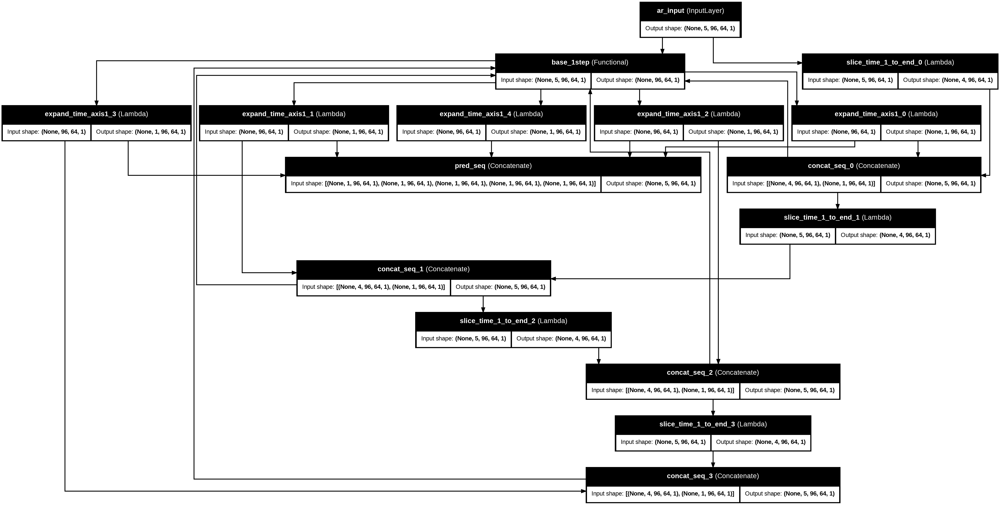

In [ ]:
# グラフを可視化
keras.utils.plot_model(ar_model, show_shapes=True, show_layer_names=True)

## 学習

In [ ]:
class TensorBoardXCallback(keras.callbacks.Callback):
    def __init__(self, val_sample):
        super().__init__()
        # --- JMA カラーマップ ---
        cmap_hex = ["#f2f2ff","#a0d2ff","#218cff","#0000ff",
                    "#faf500","#ff9900","#ff2100","#c800c8"]
        self.jma_colors = np.array([[int(h[i:i+2],16)/255. for i in (1,3,5)]
                                    for h in cmap_hex], dtype=np.float32)
        self.color_border = [0,1,5,10,20,30,50,80,1000]


        self.sample_x = val_sample  # 1 バッチだけ保持しておく

    def on_train_begin(self, logs=None):
        self.writer = tensorboardX.SummaryWriter()

    def on_epoch_end(self, epoch, logs=None):
        # ------ 損失を記録 ------
        self.writer.add_scalar("loss/train", logs["loss"],     epoch)
        self.writer.add_scalar("loss/val",   logs["val_loss"], epoch)

        # ------ 推論画像を記録 ------
        pred = self.model.predict(self.sample_x, verbose=0)[0]     # (H,W,1)
        pred = np.clip(pred[...,0], 0, 1000)                       # (H,W)

        idx  = np.digitize(pred, self.color_border) - 1            # (H,W)
        rgb  = self.jma_colors[idx]                                # (H,W,3)
        rgb  = rgb.transpose(2,0,1)[None,...]                      # (1,3,H,W)

        self.writer.add_images("pred", rgb, epoch)

In [ ]:
# QUICK_EPOCHS = 1
# QUICK_STEPS  = 1
# QUICK_VAL_STEPS = 1
# # ----------------------------

# history = ar_model.fit(
#     train_gen,
#     steps_per_epoch = QUICK_STEPS,     # ← 1バッチだけ
#     epochs          = QUICK_EPOCHS,    # ← 1エポックだけ
#     validation_data = val_gen,
#     validation_steps= QUICK_VAL_STEPS, # ← 検証も1バッチだけ（任意）
#     callbacks=[
#         keras.callbacks.TerminateOnNaN(),  # 早期停止などは外して軽量化
#     ],
# )

In [ ]:
# model = ar_model

ar_model.fit(
    train_gen,
    steps_per_epoch=steps_per_epoch,
    epochs=EPOCHS,
    validation_data=val_gen,
    validation_steps=val_steps,
    callbacks=[
        keras.callbacks.EarlyStopping(patience=15, restore_best_weights=True),
        # keras.callbacks.ReduceLROnPlateau(),
        keras.callbacks.TerminateOnNaN()
        # TensorBoardXCallback(val_sample_x[:1]),
    ],
)

Epoch 1/200
7150/7150 ━━━━━━━━━━━━━━━━━━━━ 2289s 320ms/step - loss: 1.6119e-04 - val_loss: 1.5581e-04
Epoch 2/200
7150/7150 ━━━━━━━━━━━━━━━━━━━━ 2280s 319ms/step - loss: 1.4371e-04 - val_loss: 1.6305e-04
Epoch 3/200
7150/7150 ━━━━━━━━━━━━━━━━━━━━ 2278s 319ms/step - loss: 1.3990e-04 - val_loss: 1.6476e-04
Epoch 4/200
7150/7150 ━━━━━━━━━━━━━━━━━━━━ 2288s 320ms/step - loss: 1.2978e-04 - val_loss: 1.5645e-04
Epoch 5/200
7150/7150 ━━━━━━━━━━━━━━━━━━━━ 2302s 322ms/step - loss: 1.1450e-04 - val_loss: 1.5775e-04
Epoch 6/200
7150/7150 ━━━━━━━━━━━━━━━━━━━━ 2293s 321ms/step - loss: 1.1017e-04 - val_loss: 1.5817e-04
Epoch 7/200
3057/7150 ━━━━━━━━━━━━━━━━━━━━ 19:43 289ms/step - loss: 1.0417e-04

In [ ]:
import datetime as dt

save_dir = "/content/drive/MyDrive/climate_data_platform/model"

basename = f"ar_transformer_{dt.datetime.now():%Y%m%d}_e{EPOCHS}"
model_save_path = f"{save_dir}/{basename}.keras"   # Keras v3 推奨の単一ファイル形式

ar_model.save(model_save_path, include_optimizer=False)
print("saved to:", model_save_path)

weight_save_path = f"{save_dir}/{basename}.weights.h5"
ar_model.save_weights(weight_save_path)
print("saved weights to:", weight_save_path)

saved to: /content/drive/MyDrive/climate_data_platform/model/ar_transformer_20250814_e200.keras
saved weights to: /content/drive/MyDrive/climate_data_platform/model/ar_transformer_20250814_e200.weights.h5


# 学習結果の表示

In [ ]:
import keras
from keras.saving import register_keras_serializable

# ==== 保存時に使った関数をすべて再定義 & 登録（本体 + shape）====

@register_keras_serializable(package="xrain")
def take_last_frame_channel0(t):        # (B,T,H,W,1) -> (B,H,W)
    return t[:, -1, ..., 0]

@register_keras_serializable(package="xrain")
def last_frame_output_shape(s):         # s=(B,T,H,W,1) -> (B,H,W)
    return (s[0], s[2], s[3])

@register_keras_serializable(package="xrain")
def expand_time_axis1(x):               # (B,H,W,1) -> (B,1,H,W,1)
    return keras.ops.expand_dims(x, 1)

@register_keras_serializable(package="xrain")
def expand_time_axis1_shape(s):         # s=(B,H,W,1) -> (B,1,H,W,1)
    return (s[0], 1, s[1], s[2], s[3])

@register_keras_serializable(package="xrain")
def slice_time_1_to_end(x):             # (B,T,H,W,1) -> (B,T-1,H,W,1)
    return x[:, 1:, ...]

@register_keras_serializable(package="xrain")
def slice_time_1_to_end_shape(s):       # s=(B,T,H,W,1) -> (B,T-1,H,W,1)
    return (s[0], s[1]-1, s[2], s[3], s[4])

@register_keras_serializable(package="xrain")
def take_last_time(x):                  # (B,N,H,W,1) -> (B,H,W,1)
    return x[:, -1, ...]

@register_keras_serializable(package="xrain")
def take_last_time_shape(s):            # s=(B,N,H,W,1) -> (B,H,W,1)
    return (s[0], s[2], s[3], s[4])

# もし学習時に loss も保存していた場合は（今回は include_optimizer=False なので不要）
# @register_keras_serializable(package="xrain")
# def focal_log1p_mse(y_true, y_pred, thr=1.0, alpha=4.0):
#     yt = keras.ops.log1p(y_true / SCALE_FACTOR)
#     yp = keras.ops.log1p(y_pred / SCALE_FACTOR)
#     base = keras.ops.square(yt - yp)
#     w = 1.0 + alpha * keras.ops.cast(y_true >= thr, "float32")
#     return keras.ops.mean(w * base)

# ==== ロード ====
LOAD_PATH = "/content/drive/MyDrive/climate_data_platform/model/ar_transformer_20250814_e200.keras"
print("loading:", LOAD_PATH)

ar_model = keras.models.load_model(
    LOAD_PATH,
    compile=False,
    safe_mode=False,
    custom_objects={
        # Lambda 本体
        "take_last_frame_channel0": take_last_frame_channel0,
        "expand_time_axis1":        expand_time_axis1,
        "slice_time_1_to_end":      slice_time_1_to_end,
        "take_last_time":           take_last_time,
        # Lambda の output_shape
        "last_frame_output_shape":     last_frame_output_shape,
        "expand_time_axis1_shape":     expand_time_axis1_shape,
        "slice_time_1_to_end_shape":   slice_time_1_to_end_shape,
        "take_last_time_shape":        take_last_time_shape,
        # 必要なら loss も
        # "focal_log1p_mse": focal_log1p_mse,
    },
)

# # 簡易チェック
# i = SEQ_LEN
# x_in = make_input_seq(val_rains, i)     # (1, SEQ_LEN, H, W, 1)
# y    = ar_model.predict(x_in, verbose=0)[0]
# print("pred shape:", y.shape)           # 期待: (H, W, 1) または (H, W)

loading: /content/drive/MyDrive/climate_data_platform/model/ar_transformer_20250814_e200.keras


In [ ]:
import matplotlib.pyplot as plt
import matplotlib.colors as mcolors

plt.ioff()  # jupyter notebookで自動的にグラフが表示されないようにする

jma_colors = [
    "#f2f2ff",
    "#a0d2ff",
    "#218cff",
    "#0000ff",
    "#faf500",
    "#ff9900",
    "#ff2100",
    "#c800c8",
]
jma_bounds = [0, 1, 5, 10, 20, 30, 50, 80, 1000]
jma_cmap = mcolors.ListedColormap(jma_colors)
jma_norm = mcolors.BoundaryNorm(jma_bounds, jma_cmap.N)
jma_cmap.set_bad("#ffffff")

In [ ]:
import matplotlib.figure


# 2つの雨量データを並べて表示する関数
def plot2(fig: matplotlib.figure.Figure, data0, data1):
    ax0 = fig.add_subplot(1, 2, 1)
    ax1 = fig.add_subplot(1, 2, 2)

    # 配色用の ScalarMappable を一度だけ生成
    sm = plt.cm.ScalarMappable(cmap=jma_cmap, norm=jma_norm)
    sm.set_array([])

    cax = fig.add_axes([0.92, 0.15, 0.02, 0.7])
    fig.colorbar(sm, cax=cax, orientation="vertical",
                 boundaries=jma_bounds, spacing="uniform",
                 ticks=[1,5,10,20,30,50,80]).set_label("mm/h")

    ax0.imshow(data0, cmap=jma_cmap, norm=jma_norm)
    ax1.imshow(data1, cmap=jma_cmap, norm=jma_norm)
    ax0.set_title("input")
    ax1.set_title("output")

In [ ]:
def make_input_seq(rains: np.ndarray, t: int, seq_len: int = SEQ_LEN):
    """
    t-seq_len … t-1 の窓を (1,T,H,W,1) で返す
    行 = 緯度(LAT_SLICE) / 列 = 経度(LON_SLICE)
    """
    assert t >= seq_len, "t は SEQ_LEN 以上にしてください"

    seq = rains[t-seq_len : t,
                LAT_SLICE,   # ← 行方向 = 緯度
                LON_SLICE]   # ← 列方向 = 経度
    seq = seq[:, ::DOWNSAMPLE, ::DOWNSAMPLE]   # 10 倍間引き
    seq = seq[..., None]                       # (T,H,W,1)
    return seq[np.newaxis].astype("float32")

## まずtrain dataを学習できているか

### base_1step を使う場合（出力は 1 step先）

In [ ]:
import numpy as np, matplotlib.pyplot as plt
import matplotlib.animation as animation
from tqdm import tqdm
import keras

t0 = 0
# 評価対象の範囲: [SEQ_LEN, T_total - N_STEPS]
T_total     = train_rains.shape[0]
t_begin     = SEQ_LEN
t_end_excl  = T_total - N_STEPS + 1         # 真値がはみ出さない上限
predict_num = t_end_excl - t_begin

predict_train = np.empty((predict_num, H, W), dtype="float32")

def make_input_seq_at(arr, t_end):
    # t_end 時刻は含まず、直前までの SEQ_LEN 枚を入力にする
    win = arr[t_end-SEQ_LEN:t_end, LAT_SLICE, LON_SLICE][:, ::DOWNSAMPLE, ::DOWNSAMPLE]
    return win[np.newaxis, ..., np.newaxis].astype("float32")  # (1,SEQ_LEN,H,W,1)

for k in tqdm(range(predict_num), desc="inferring train set"):
    t_end = t_begin + k                     # 入力窓の終端（非包含）
    x_in  = make_input_seq_at(train_rains, t_end)
    # 1歩モデルの出力は +1 先。教師は +N_STEPS 先なので「N_STEPS-1 回」前進させる
    y = keras.ops.convert_to_numpy(model(x_in, training=False))[0]
    for _ in range(N_STEPS-1):
        x_in = np.concatenate([x_in[:,1:], y[np.newaxis, ..., np.newaxis]], axis=1)
        y = keras.ops.convert_to_numpy(model(x_in, training=False))[0]
    predict_train[k] = y

print("predict_train.shape:", predict_train.shape)

# val でも同様に、真値は i + (N_STEPS-1) を可視化
i = SEQ_LEN
x_in = make_input_seq_at(val_rains, i)
y_pred = model.predict(x_in, verbose=0)[0]
for _ in range(N_STEPS-1):
    x_in  = np.concatenate([x_in[:,1:], y_pred[np.newaxis, ..., np.newaxis]], axis=1)
    y_pred = model.predict(x_in, verbose=0)[0]

y_true = val_rains[i + (N_STEPS-1), LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
fig = plt.figure(figsize=(8,4))
plot2(fig, y_true, y_pred)
plt.tight_layout()
plt.show()

In [ ]:
# ─────────────────────────────────────────────────────────
# 3. 可視化設定（JMA カラーマップを使った左右比較）
# ─────────────────────────────────────────────────────────
import matplotlib.figure

def plot2(fig: matplotlib.figure.Figure, left, right):
    axes = [fig.add_subplot(1,2,1), fig.add_subplot(1,2,2)]
    sm = plt.cm.ScalarMappable(cmap=jma_cmap, norm=jma_norm)
    sm.set_array([])

    fig.colorbar(
        sm, ax=axes, orientation="vertical",
        boundaries=jma_bounds, spacing="uniform",
        ticks=[1,5,10,20,30,50,80], shrink=0.5, pad=0.04
    ).set_label("mm/h")

    axes[0].imshow(left,  cmap=jma_cmap, norm=jma_norm)
    axes[1].imshow(right, cmap=jma_cmap, norm=jma_norm)
    axes[0].set_title("input")
    axes[1].set_title("output")
    for ax in axes: ax.set_axis_off()

# ─────────────────────────────────────────────────────────
# 4. アニメーション生成
# ─────────────────────────────────────────────────────────
fig = plt.figure(figsize=(10,5))

def update(idx):
    fig.clear()
    # 入力は「直近 1 枚の真値」を表示
    true_frame = train_rains[t0 + SEQ_LEN + idx,
                             LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    plot2(fig, true_frame, predict_train[idx])

ani = animation.FuncAnimation(
    fig, update, frames=predict_num, interval=200
)

ani.save("predict_train.mp4", writer="ffmpeg", dpi=150, fps=5)
print("saved: predict_train.mp4")

inferring train set: 100%|██████████| 1434/1434 [01:09<00:00, 20.50it/s]


predict_train.shape: (1434, 96, 64)
saved: predict_train.mp4


In [ ]:
from IPython.display import HTML, Video
from base64 import b64encode

mp4 = open('predict_train.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width="800" controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")

### ar_model を使う場合（1 回で N_STEPS 枚返す）

In [ ]:
T_total     = train_rains.shape[0]
t_begin     = SEQ_LEN
t_end_excl  = T_total - N_STEPS + 1
predict_num = t_end_excl - t_begin

predict_train = np.empty((predict_num, H, W), dtype="float32")

for k in tqdm(range(predict_num), desc="inferring train set"):
    t_end = t_begin + k
    x_in  = make_input_seq_at(train_rains, t_end)      # (1,SEQ_LEN,H,W,1)
    y_seq = ar_model.predict(x_in, verbose=0)[0]       # (N_STEPS,H,W) か (N_STEPS,H,W,1)
    if y_seq.ndim == 4: y_seq = y_seq[...,0]
    predict_train[k] = y_seq[-1]                       # 最後の1枚（+N_STEPS 先）

In [ ]:
fig = plt.figure(figsize=(10,5))

def update(idx):
    fig.clear()
    # 入力は「直近 1 枚の真値」を表示
    true_frame = train_rains[t0 + SEQ_LEN + idx,
                             LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    plot2(fig, true_frame, predict_train[idx])

ani = animation.FuncAnimation(
    fig, update, frames=predict_num, interval=200
)

ani.save("predict_train.mp4", writer="ffmpeg", dpi=150, fps=5)
print("saved: predict_train.mp4")

from IPython.display import HTML, Video
from base64 import b64encode

mp4 = open('predict_train.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width="800" controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")

## val data に対して推論

### base_1step を使う場合（出力は 1 step先）

/tmp/ipython-input-1562360223.py:13: UserWarning: This figure includes Axes that are not compatible with tight_layout, so results might be incorrect.
  plt.tight_layout()


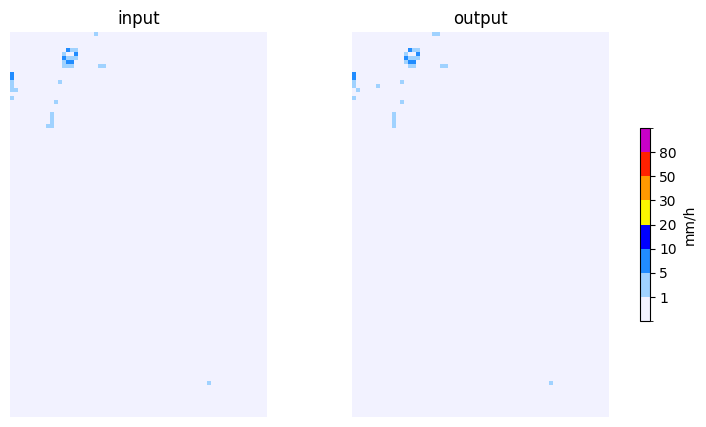

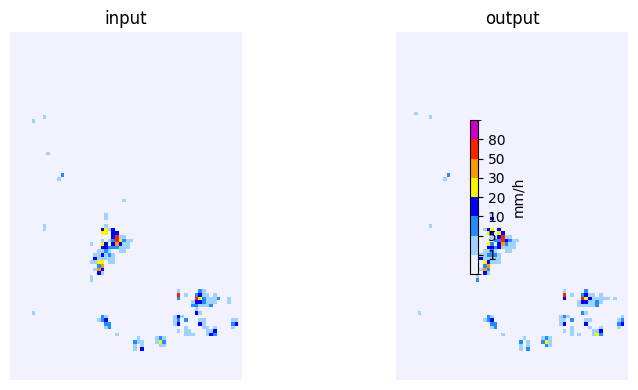

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation

# ---- ユーティリティ：窓終端 t_end から N_STEPS 先を1歩モデルで予測 ----
def predict_N_ahead_from(val_arr, t_end):
    """
    val_arr: (T, Y, X)
    t_end  : 入力窓の終端インデックス（非包含）=> 入力は [t_end-SEQ_LEN, ..., t_end-1]
    返り値 : 予測 (H, W)   （t_end+(N_STEPS-1) の予測）
    """
    # 入力窓を用意 (1, SEQ_LEN, H, W, 1)
    x_in = make_input_seq(val_arr, t_end)

    # 1歩モデルを N_STEPS 回まわして先へ進める
    y_pred = model.predict(x_in, verbose=0)[0]         # +1 先の (H,W) または (H,W,1)
    if y_pred.ndim == 3:
        y_pred = y_pred[..., 0]

    for _ in range(N_STEPS - 1):
        # 直近予測を窓の末尾に入れてさらに1歩先を予測
        x_in = np.concatenate([x_in[:, 1:], y_pred[np.newaxis, ..., np.newaxis]], axis=1)
        y_pred = model.predict(x_in, verbose=0)[0]
        if y_pred.ndim == 3:
            y_pred = y_pred[..., 0]
    return y_pred.astype("float32")                    # (H, W)

# ---- アニメーション設定 ----
T_total     = val_rains.shape[0]
# 比較できる範囲：真値が存在するところまで（N_STEPS 分の余白に注意）
predict_num = T_total - SEQ_LEN - N_STEPS + 1
assert predict_num > 0, "predict_num <= 0。SEQ_LEN/N_STEPS/系列長を確認してください。"

fig = plt.figure(figsize=(10, 5))

def update(idx):
    fig.clear()
    # 入力窓の終端（非包含）。窓は [t_end-SEQ_LEN .. t_end-1]
    t_end = SEQ_LEN + idx

    # 予測（N_STEPS 回の自己回帰）
    y_pred = predict_N_ahead_from(val_rains, t_end)    # (H, W)

    # 真値は N_STEPS 先のフレーム
    y_true = val_rains[
        t_end + (N_STEPS - 1),
        LAT_SLICE, LON_SLICE
    ][::DOWNSAMPLE, ::DOWNSAMPLE].astype("float32")    # (H, W)

    plot2(fig, y_true, y_pred)  # 左=真値 / 右=予測

ani = animation.FuncAnimation(fig, update, frames=predict_num, interval=200)

ani.save("predict_val_ar1step.mp4", writer="ffmpeg", dpi=150, fps=5)
print("saved: predict_val_ar1step.mp4")

In [ ]:
# 動画のプレビュー
from IPython.display import HTML, Video
from base64 import b64encode

In [ ]:
mp4 = open('predict_val_ar1step.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width="800" controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")

### ar_model: N 枚まとめて出す

In [ ]:
i = SEQ_LEN
x_in = make_input_seq(val_rains, i)                    # (1, SEQ_LEN, H, W, 1)

# 出力が (N_STEPS, H, W) または (N_STEPS, H, W, 1) を想定
y_seq = ar_model.predict(x_in, verbose=0)[0]
if y_seq.ndim == 4:                                    # (N_STEPS, H, W, 1) → (N_STEPS, H, W)
    y_seq = y_seq[..., 0]

y_pred = y_seq[-1]                                     # +N_STEPS 先
y_true = val_rains[i + (N_STEPS - 1), LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]

fig = plt.figure(figsize=(8,4))
plot2(fig, y_true, y_pred)
plt.tight_layout(); plt.show()

In [ ]:
T_total     = val_rains.shape[0]
predict_num = T_total - SEQ_LEN - N_STEPS + 1   # ここが重要

USE_BASE_1STEP = False

def frame_pred_at(t_end):  # 入力窓の終端 t_end（真値は t_end+N_STEPS-1）
    x_in = make_input_seq(val_rains, t_end)
    if USE_BASE_1STEP:
        y = model.predict(x_in, verbose=0)[0]
        for _ in range(N_STEPS-1):
            x_in = np.concatenate([x_in[:,1:], y[np.newaxis, ..., np.newaxis]], axis=1)
            y = model.predict(x_in, verbose=0)[0]
        return y
    else:
        y_seq = ar_model.predict(x_in, verbose=0)[0]
        if y_seq.ndim == 4: y_seq = y_seq[...,0]
        return y_seq[-1]

fig = plt.figure(figsize=(10,5))
def update(idx):
    fig.clear()
    t_end  = SEQ_LEN + idx
    y_true = val_rains[t_end + (N_STEPS-1), LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    y_pred = frame_pred_at(t_end)
    plot2(fig, y_true, y_pred)

ani = animation.FuncAnimation(fig, update, frames=predict_num, interval=200)

In [ ]:
ani.save("predict_val_arnstep.mp4", writer="ffmpeg", dpi=150, fps=5)
print("saved: predict_val_arnstep.mp4")

In [ ]:
mp4 = open('predict_val_arnstep.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width="800" controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")

## 自己回帰

### base_1step（1 枚ずつ進める）

In [ ]:
import numpy as np
from collections import deque

T_total     = val_rains.shape[0]
predict_num = T_total - SEQ_LEN

history = deque(maxlen=SEQ_LEN)
for t in range(SEQ_LEN):
    f = val_rains[t, LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    history.append(f.astype("float32"))

preds = []
i = 0
while i < predict_num:
    x = np.stack(history, axis=0)[np.newaxis, ..., np.newaxis]
    y_seq = ar_model.predict(x, verbose=0)[0]      # (N_STEPS,H,W) or (...,1)
    if y_seq.ndim == 4: y_seq = y_seq[...,0]
    for y in y_seq:
        if i >= predict_num: break
        preds.append(y); history.append(y.astype("float32")); i += 1

predict_rain = np.stack(preds, axis=0).astype("float32")
print("predict_rain.shape =", predict_rain.shape)

ValueError: Input 0 of layer "ARx6" is incompatible with the layer: expected shape=(None, 5, 96, 64, 1), found shape=(1, 5, 64, 1)

In [ ]:
USE_BASE_1STEP = ('ar_model' not in globals()) or (ar_model is None)

# ------------------------------------------------------------
# 1. 自己回帰で val を全区間予測
# ------------------------------------------------------------
t0          = 0
T_total     = val_rains.shape[0]
predict_num = T_total - SEQ_LEN               # 生成する予測枚数

# 先頭 SEQ_LEN 枚は真値でウォームアップ
history = deque(maxlen=SEQ_LEN)
for t in range(SEQ_LEN):
    f = val_rains[t, LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    history.append(f.astype("float32"))

predict_val = np.empty((predict_num, H, W), dtype="float32")

if USE_BASE_1STEP:
    # ---- 1歩モデル：1枚ずつ前進 ----
    for i in tqdm(range(predict_num), desc="AR infer (1-step)"):
        x = np.stack(history, axis=0)[np.newaxis, ..., np.newaxis]  # (1,SEQ_LEN,H,W,1)
        y = model.predict(x, verbose=0)[0]                           # (H,W) or (H,W,1)
        if y.ndim == 3: y = y[..., 0]
        predict_val[i] = y
        history.append(y.astype("float32"))
else:
    # ---- 多段モデル：N_STEPS ずつまとめて前進 ----
    i = 0
    while i < predict_num:
        x = np.stack(history, axis=0)[np.newaxis, ..., np.newaxis]  # (1,SEQ_LEN,H,W,1)
        y_seq = ar_model.predict(x, verbose=0)[0]                    # (N_STEPS,H,W[,1])
        if y_seq.ndim == 4: y_seq = y_seq[..., 0]
        for y in y_seq:
            if i >= predict_num: break
            predict_val[i] = y
            history.append(y.astype("float32"))
            i += 1

print("predict_val.shape =", predict_val.shape)

# ------------------------------------------------------------
# 2. アニメーション（左: 真値 / 右: 自己回帰予測）
#    plot2(fig, left, right) はユーザー定義をそのまま使用
# ------------------------------------------------------------
fig = plt.figure(figsize=(10, 5))

def update(idx):
    fig.clear()
    # 真値（現在のフレーム）
    true_frame = val_rains[t0 + SEQ_LEN + idx,
                           LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    plot2(fig, true_frame, predict_val[idx])

ani = animation.FuncAnimation(fig, update, frames=predict_num, interval=200)

# 保存（必要なら）
ani.save("predict_val_self.mp4", writer="ffmpeg", dpi=150, fps=5)
print("saved: predict_val_self.mp4")

In [ ]:
mp4 = open('predict_val_self.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width="800" controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")

### ar_model（N_STEPS ずつ進める）

In [ ]:
def plot2(fig: matplotlib.figure.Figure, left, right):
    axes = [fig.add_subplot(1,2,1), fig.add_subplot(1,2,2)]
    sm = plt.cm.ScalarMappable(cmap=jma_cmap, norm=jma_norm)
    sm.set_array([])

    fig.colorbar(
        sm, ax=axes, orientation="vertical",
        boundaries=jma_bounds, spacing="uniform",
        ticks=[1,5,10,20,30,50,80], shrink=0.5, pad=0.04
    ).set_label("mm/h")

    axes[0].imshow(left,  cmap=jma_cmap, norm=jma_norm)
    axes[1].imshow(right, cmap=jma_cmap, norm=jma_norm)
    axes[0].set_title("truth (t)")
    axes[1].set_title("pred (t+1 ...)")
    for ax in axes: ax.set_axis_off()

In [ ]:
from collections import deque

T_total     = val_rains.shape[0]
predict_num = T_total - SEQ_LEN

history = deque(maxlen=SEQ_LEN)
for t in range(SEQ_LEN):
    f = val_rains[t, LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    history.append(f.astype("float32"))

preds = []
i = 0
while i < predict_num:
    x = np.stack(history, axis=0)[np.newaxis, ..., np.newaxis]
    y_seq = ar_model.predict(x, verbose=0)[0]      # (N_STEPS,H,W) or (...,1)
    if y_seq.ndim == 4: y_seq = y_seq[...,0]
    for y in y_seq:
        if i >= predict_num: break
        preds.append(y); history.append(y.astype("float32")); i += 1

predict_rain = np.stack(preds, axis=0).astype("float32")
print("predict_rain.shape =", predict_rain.shape)

predict_rain.shape = (1435, 96, 64)


In [ ]:
def update(idx):
    fig.clear()
    # 真値フレーム：窓の終端に対応する1枚（時間は t=SEQ_LEN+idx）
    true_frame = val_rains[SEQ_LEN + idx,
                           LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    pred_frame = predict_rain[idx]  # (H,W) 想定
    if pred_frame.ndim == 3 and pred_frame.shape[-1] == 1:
        pred_frame = pred_frame[..., 0]
    plot2(fig, true_frame, pred_frame)

In [ ]:
import matplotlib.animation as animation

fig = plt.figure(figsize=(10,5))
ani = animation.FuncAnimation(
    fig, update, frames=range(predict_num), interval=200
)

writer = animation.FFMpegWriter(fps=10, codec='libx264')
ani.save("predict_val_self.mp4", writer=writer, dpi=200)

plt.close(fig)

In [ ]:
from IPython.display import HTML, Video
from base64 import b64encode

mp4 = open('predict_val_self.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width="800" controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")

### sliding window

In [ ]:
from collections import deque
import numpy as np

T_total     = val_rains.shape[0]
predict_num = T_total - SEQ_LEN

# 初期履歴の準備（変更なし）
history = deque(maxlen=SEQ_LEN)
for t in range(SEQ_LEN):
    f = val_rains[t, LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    history.append(f.astype("float32"))

preds = []
# predict_num 回、1ステップずつ予測を繰り返す
for i in range(predict_num):
    # 1. 現在の履歴から入力データを作成
    x = np.stack(history, axis=0)[np.newaxis, ..., np.newaxis]

    # 2. モデルで N_STEPS 先までを予測
    #    ar_model は常に (N_STEPS, H, W, C) の形状で出力を返す
    y_seq = ar_model.predict(x, verbose=0)[0]

    # 3. 予測結果のうち、最初の1フレーム（最も確からしい1ステップ先）のみを使用
    y_next_frame = y_seq[0]  # (H, W, 1) or (H, W)
    if y_next_frame.ndim == 3: y_next_frame = y_next_frame[..., 0]

    # 4. 予測結果を保存し、履歴を更新
    preds.append(y_next_frame)
    history.append(y_next_frame.astype("float32")) # history の一番古いフレームが自動的に捨てられる

predict_rain = np.stack(preds, axis=0).astype("float32")
print("predict_rain.shape =", predict_rain.shape)

predict_rain.shape = (1435, 96, 64)


In [ ]:
def update(idx):
    fig.clear()
    # 真値フレーム：窓の終端に対応する1枚（時間は t=SEQ_LEN+idx）
    true_frame = val_rains[SEQ_LEN + idx,
                           LAT_SLICE, LON_SLICE][::DOWNSAMPLE, ::DOWNSAMPLE]
    pred_frame = predict_rain[idx]  # (H,W) 想定
    if pred_frame.ndim == 3 and pred_frame.shape[-1] == 1:
        pred_frame = pred_frame[..., 0]
    plot2(fig, true_frame, pred_frame)

In [ ]:
import matplotlib.animation as animation

fig = plt.figure(figsize=(10,5))
ani = animation.FuncAnimation(
    fig, update, frames=range(predict_num), interval=200
)

writer = animation.FFMpegWriter(fps=10, codec='libx264')
ani.save("predict_val_self_sliding_win.mp4", writer=writer, dpi=200)

plt.close(fig)

In [ ]:
from IPython.display import HTML, Video
from base64 import b64encode

mp4 = open('predict_val_self_sliding_win.mp4','rb').read()
data_url = "data:video/mp4;base64," + b64encode(mp4).decode()

HTML(f"""
<video width="800" controls>
  <source src="{data_url}" type="video/mp4">
</video>
""")

### unassign

In [ ]:
from google.colab import runtime

runtime.unassign()

In [ ]:
## Transformer -> 位置encoding に時間を含める（時間、空間で大きさ違うことに注意）
## https://keras.io/examples/vision/image_classification_with_vision_transformer/
## MC dropout 推論にも dropout 層を入れる
## 多段階予測